## Memanggil library yang dibutuhkan



In [ ]:
import os
import glob as glob
import matplotlib.pyplot as plt
import cv2
import requests
import random
import numpy as np

np.random.seed(42)

## Menentukan Seberapa Banyak melatih model

Di sini, kita menentukan apakah akan melatih model atau tidak dan untuk berapa epochs yang akan dilatih.




In [ ]:
TRAIN = True
# Jumlah epochs yang akan di latih.
EPOCHS = 50

## Download dan Mempersiapkan Dataset


In [ ]:
if not os.path.exists('train'):
    !curl -L "https://app.roboflow.com/ds/XlDmatqCgm?key=wAxmqzwhz1"> roboflow.zip; unzip roboflow.zip; rm roboflow.zip

    dirs = ['train', 'valid', 'test']

    for i, dir_name in enumerate(dirs):
        all_image_names = sorted(os.listdir(f"{dir_name}/images/"))
        for j, image_name in enumerate(all_image_names):
            if (j % 2) == 0:
                file_name = image_name.split('.jpg')[0]
                os.remove(f"{dir_name}/images/{image_name}")
                os.remove(f"{dir_name}/labels/{file_name}.txt")

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   893  100   893    0     0   2996      0 --:--:-- --:--:-- --:--:--  2996
100 87.1M  100 87.1M    0     0  14.6M      0  0:00:05  0:00:05 --:--:-- 16.1M
Archive:  roboflow.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
 extracting: data.yaml               
   creating: test/
   creating: test/images/
 extracting: test/images/baja-13-_jpg.rf.e5e1965fe503c883d034aa3f34cb9989.jpg  
 extracting: test/images/baja-17-_jpg.rf.c506919685069299485fd5280bbc6adc.jpg  
 extracting: test/images/baja-36-_jpg.rf.462b30a0837ca4ce356f13d93ae5dd5c.jpg  
 extracting: test/images/baja-5-_jpg.rf.658add4e60cf0923882c8f9b2a693dfe.jpg  
 extracting: test/images/botol_minum-10-_jpg.rf.401c90506914871688d05a137b547201.jpg  
 extracting: test/images/botol_minum-16-_jpg.rf.ec386defa3200de973fe25ef6c9a48cb.jpg  
 extracti

Dataset disusun seperti di bawah ini:

```
├── data.yaml
├── README.dataset.txt
├── README.roboflow.txt
├── test
│   ├── images
│   └── labels
├── train
│   ├── images
│   └── labels
└── valid
    ├── images
    └── labels

```

## Fungsi tambahan untuk mendownload file

Fungsi berikut ini adalah untuk mengunduh file apa pun di dalam notebook. Pada bagian selanjutnya dari notebook, kita akan menggunakannya untuk mengunduh data inferensi

In [ ]:
def download_file(url, save_name):
    url = url
    if not os.path.exists(save_name):
        file = requests.get(url)
        open(save_name, 'wb').write(file.content)
    else:
        print('File already present, skipping download...')

### Dataset YAML File
(`data.yaml`) File ini berisi nama kelas dari dataset.

Dataset berisi 2 class: **'Organik', 'anorganik'**.

Blok berikut ini menunjukkan isi file `data.yaml`.

```yaml
train: ../train/images
val: ../valid/images

nc: 2
names: ['anorganik', 'organik']
```

### Visualisasi Beberapa Gambar

Sebelum melakukan training, mari kita periksa beberapa gambar untuk kebenaran dasar.

Anotasi saat ini dalam file teks dalam keadaan normal `[x_center, y_center, width, height]` format dan fungsi berikut akan mengonversi menjadi  `[x_min, y_min, x_max, y_max]` format.

In [ ]:
class_names = ['Anorganik', 'Organik']
colors = np.random.uniform(0, 255, size=(len(class_names), 3))

In [ ]:
# Fungsi untuk konversi bounding boxes dari YOLO format ke xmin, ymin, xmax, ymax.
def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

In [ ]:
def plot_box(image, bboxes, labels):
    # Perlu tinggi dan lebar gambar untuk melakukan denormalisasi
    # koordinat kotak pembatas
    h, w, _ = image.shape
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # denormalisasi kordinat
        xmin = int(x1*w)
        ymin = int(y1*h)
        xmax = int(x2*w)
        ymax = int(y2*h)
        width = xmax - xmin
        height = ymax - ymin

        class_name = class_names[int(labels[box_num])]

        cv2.rectangle(
            image,
            (xmin, ymin), (xmax, ymax),
            color=colors[class_names.index(class_name)],
            thickness=2
        )

        font_scale = min(1,max(3,int(w/500)))
        font_thickness = min(2, max(10,int(w/50)))

        p1, p2 = (int(xmin), int(ymin)), (int(xmax), int(ymax))
        # Lebar dan tinggi
        tw, th = cv2.getTextSize(
            class_name,
            0, fontScale=font_scale, thickness=font_thickness
        )[0]
        p2 = p1[0] + tw, p1[1] + -th - 10
        cv2.rectangle(
            image,
            p1, p2,
            color=colors[class_names.index(class_name)],
            thickness=-1,
        )
        cv2.putText(
            image,
            class_name,
            (xmin+1, ymin-10),
            cv2.FONT_HERSHEY_SIMPLEX,
            font_scale,
            (255, 255, 255),
            font_thickness
        )
    return image

In [ ]:
# Fungsi untuk plot gambar dengan bounding boxes.
def plot(image_paths, label_paths, num_samples):
    all_training_images = glob.glob(image_paths)
    all_training_labels = glob.glob(label_paths)
    all_training_images.sort()
    all_training_labels.sort()

    num_images = len(all_training_images)

    plt.figure(figsize=(15, 12))
    for i in range(num_samples):
        j = random.randint(0,num_images-1)
        image = cv2.imread(all_training_images[j])
        with open(all_training_labels[j], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                label = label_line[0]
                bbox_string = label_line[2:]
                x_c, y_c, w, h = bbox_string.split(' ')
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)
        result_image = plot_box(image, bboxes, labels)
        plt.subplot(2, 2, i+1)
        plt.imshow(result_image[:, :, ::-1])
        plt.axis('off')
    plt.subplots_adjust(wspace=0)
    plt.tight_layout()
    plt.show()

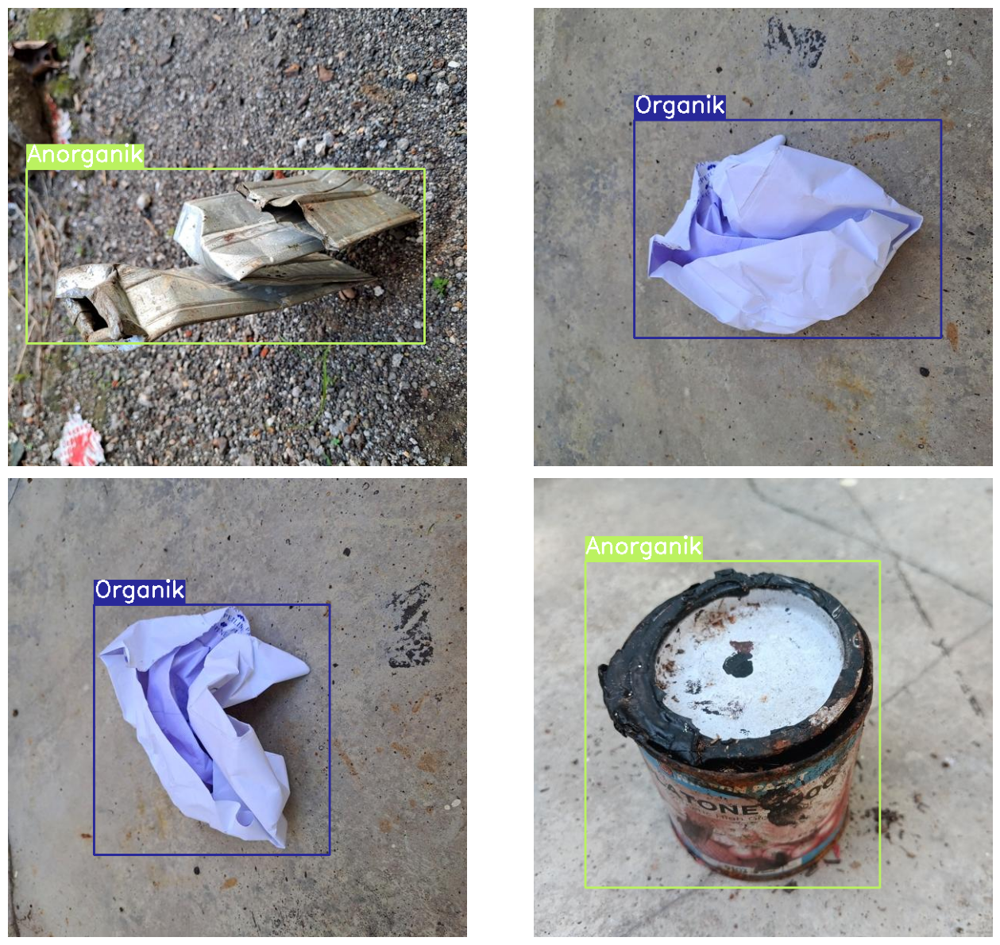

In [ ]:
# Memvisualisasikan beberapa gambar training.
plot(
    image_paths='train/images/*',
    label_paths='train/labels/*',
    num_samples=4,
)

## Helper Functions for Logging

Pada bagian ini berfungsi membuat direktori untuk menyimpan hasil dari notebook pada saat training data.


In [ ]:
def set_res_dir():
    # Direktori untuk menyimpan hasil
    res_dir_count = len(glob.glob('runs/train/*'))
    print(f"Current number of result directories: {res_dir_count}")
    if TRAIN:
        RES_DIR = f"results_{res_dir_count+1}"
        print(RES_DIR)
    else:
        RES_DIR = f"results_{res_dir_count}"
    return RES_DIR

## Clone YOLOV5 Repository

In [ ]:
if not os.path.exists('yolov5'):
    !git clone https://github.com/ultralytics/yolov5.git

In [ ]:
%cd yolov5/
!pwd

/content/yolov5
/content/yolov5


In [ ]:
!pip install -r requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 kB 9.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 595.6/595.6 kB 50.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 9.7 MB/s eta 0:00:00


## Training Data

Langkah selanjutnya adalah melatih Convoluton Network model

In [ ]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data ../data.yaml --weights yolov5s.pt \
    --img 640 --epochs {EPOCHS} --batch-size 32 --name {RES_DIR}

Current number of result directories: 0
results_1
train: weights=yolov5s.pt, cfg=, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=32, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=results_1, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-178-ga199480 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor

## Melihat Prediksi Validasi dan Inferensi

Pada bagian ini, kita akan memeriksa prediksi gambar validasi yang disimpan selama training dan juga akan memeriksa inferensi gambar

### Utilitas Visualisasi dan Inferensi

Kita akan memvisualisasikan gambar prediksi validasi yang disimpan selama training.

In [ ]:
# Funsgi untuk menampilkan prediksi validasi yang disimpan selama training.
def show_valid_results(RES_DIR):
    !ls runs/train/{RES_DIR}
    EXP_PATH = f"runs/train/{RES_DIR}"
    validation_pred_images = glob.glob(f"{EXP_PATH}/*_pred.jpg")
    print(validation_pred_images)
    for pred_image in validation_pred_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

Fungsi berikut adalah untuk melakukan inferensi pada gambar.

In [ ]:
def inference(RES_DIR, data_path):
    # Direktori untuk menyimpan hasil inferensi.
    infer_dir_count = len(glob.glob('runs/detect/*'))
    print(f"Current number of inference detection directories: {infer_dir_count}")
    INFER_DIR = f"inference_{infer_dir_count+1}"
    print(INFER_DIR)
    # Inferensi pada gambar.
    !python detect.py --weights runs/train/{RES_DIR}/weights/best.pt \
    --source {data_path} --name {INFER_DIR}
    return INFER_DIR

Kita perlu memvisualisasikan gambar di salah satu direktori. Fungsi berikut menerima jalur direktori dan memplot semua gambar di dalamnya.

In [ ]:
def visualize(INFER_DIR):
# visualisai inferensi gambar.
    INFER_PATH = f"runs/detect/{INFER_DIR}"
    infer_images = glob.glob(f"{INFER_PATH}/*.jpg")
    print(infer_images)
    for pred_image in infer_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

**Visualisasi gambar prediksi validasi.**

confusion_matrix.png				    R_curve.png
events.out.tfevents.1686393772.5d28618c8f9b.1132.0  results.csv
F1_curve.png					    results.png
hyp.yaml					    train_batch0.jpg
labels_correlogram.jpg				    train_batch1.jpg
labels.jpg					    train_batch2.jpg
opt.yaml					    val_batch0_labels.jpg
P_curve.png					    val_batch0_pred.jpg
PR_curve.png					    weights
['runs/train/results_1/val_batch0_pred.jpg']


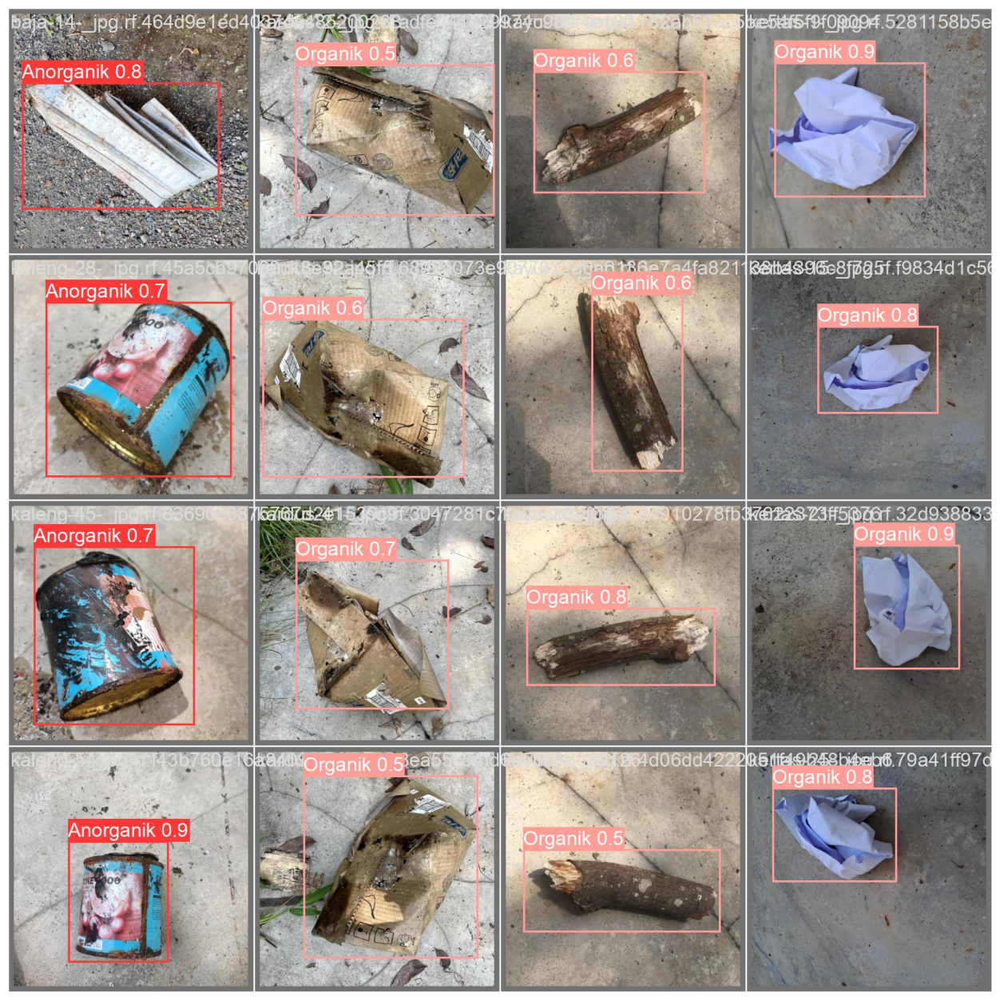

In [ ]:
show_valid_results(RES_DIR)

Hasil


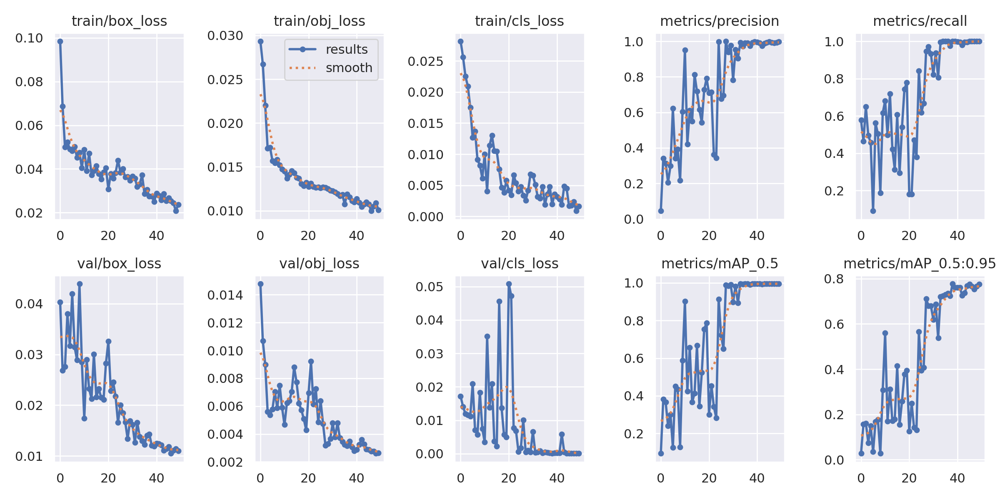

Confusion Matrix


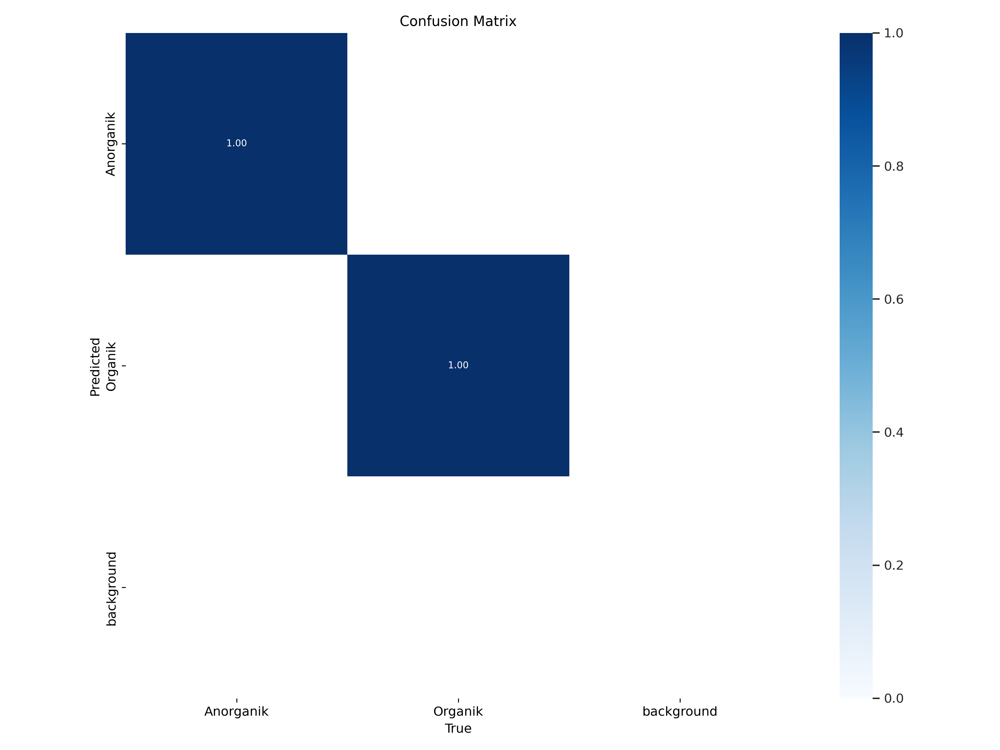

Precision


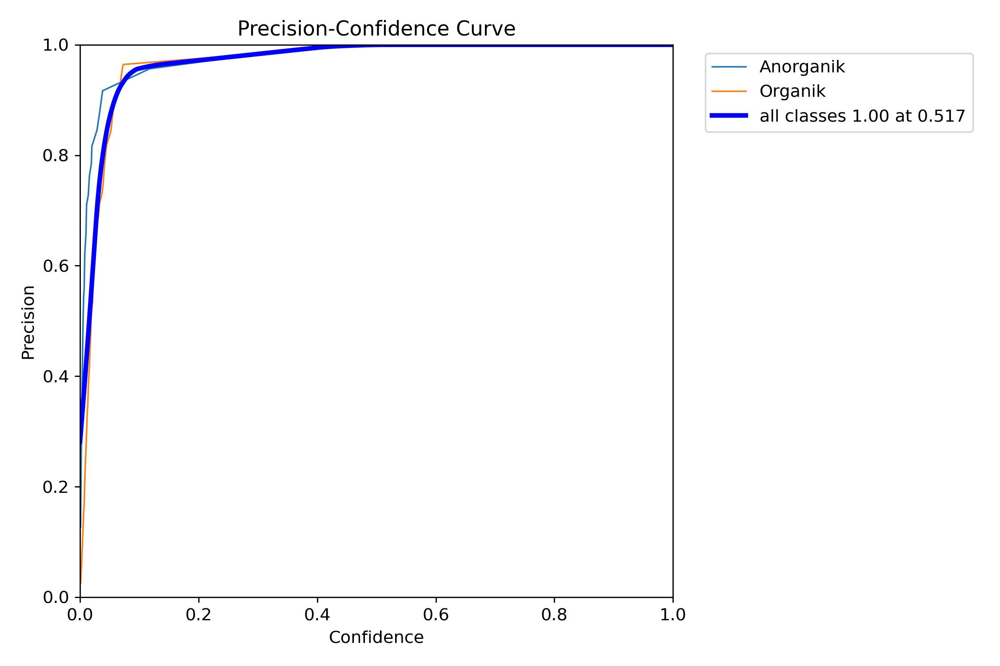

Recall


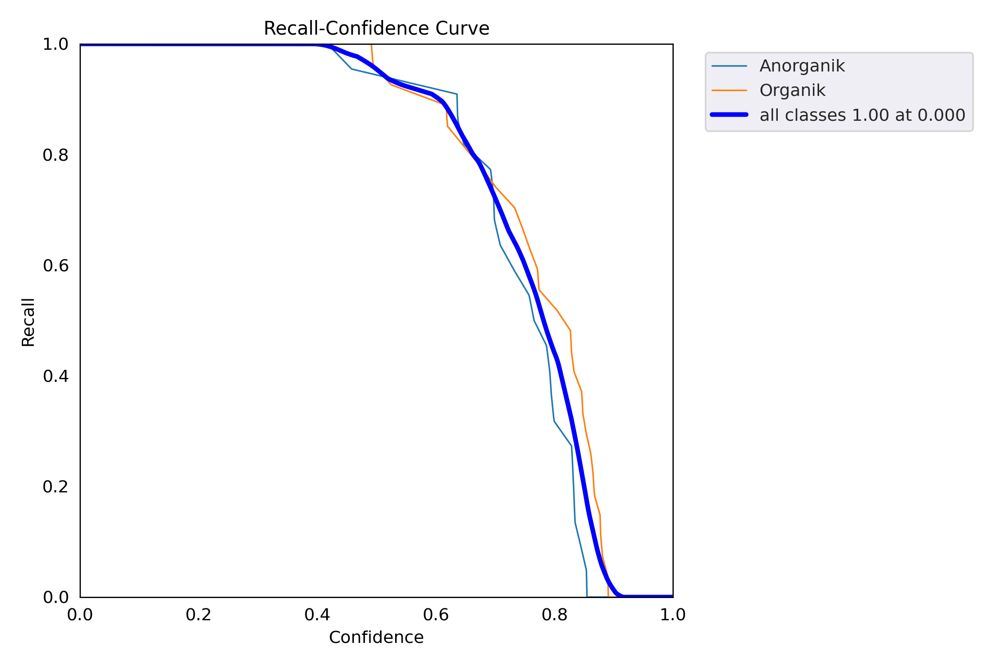

In [ ]:
from google.colab.patches import cv2_imshow
results=cv2.imread('/content/yolov5/runs/train/results_1/results.png')
matrix=cv2.imread('/content/yolov5/runs/train/results_1/confusion_matrix.png')
p=cv2.imread('/content/yolov5/runs/train/results_1/P_curve.png')
r=cv2.imread('/content/yolov5/runs/train/results_1/R_curve.png')

print('Hasil')
cv2_imshow(results)
print('Confusion Matrix')
cv2_imshow(matrix)
print('Precision')
cv2_imshow(p)
print('Recall')
cv2_imshow(r)

In [ ]:
# Inference on images.
IMAGE_INFER_DIR = inference(RES_DIR, '../test/images')

Current number of inference detection directories: 0
inference_1
detect: weights=['runs/train/results_1/weights/best.pt'], source=../test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_1, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-178-ga199480 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
image 1/28 /content/test/images/baja-17-_jpg.rf.c506919685069299485fd5280bbc6adc.jpg: 640x640 1 Anorganik, 11.5ms
image 2/28 /content/test/images/baja-5-_jpg.rf.658add4e60cf0923882c8f9b2a693dfe.jpg: 640x640 1 Anorganik, 11.5ms
image 3/28 /content/test/images/botol_minum-1

['runs/detect/inference_1/kaleng-10-_jpg.rf.4ef37c3159375a100a5688c990296037.jpg', 'runs/detect/inference_1/botol_minum-43-_jpg.rf.54ae5408aa904f6d9479c6de03705c4d.jpg', 'runs/detect/inference_1/kardus-22-_jpg.rf.4a8b3315d28ad00f7e160575d7775c9b.jpg', 'runs/detect/inference_1/kertas-16-_jpg.rf.c8f821372ad5f68f4355391c9f3bed1e.jpg', 'runs/detect/inference_1/daun-37-_jpg.rf.03f0768569e1e30186dfd0559c65d5a2.jpg', 'runs/detect/inference_1/tissue-22-_jpg.rf.0d952f08460b04f2a0d24b91c31e4170.jpg', 'runs/detect/inference_1/bungkus_makanan-42-_jpg.rf.0ce301764e0cbdcf69209695b76c8a79.jpg', 'runs/detect/inference_1/botol_minum-16-_jpg.rf.ec386defa3200de973fe25ef6c9a48cb.jpg', 'runs/detect/inference_1/baja-17-_jpg.rf.c506919685069299485fd5280bbc6adc.jpg', 'runs/detect/inference_1/kardus-6-_jpg.rf.74e9138a70ce099d922925441b53a977.jpg', 'runs/detect/inference_1/kertas-3-_jpg.rf.75066f2a2011cab016feeefcd17fac31.jpg', 'runs/detect/inference_1/kaca-18-_jpg.rf.601c9b13691b52d7cb78aaff18cd4c62.jpg', 'run

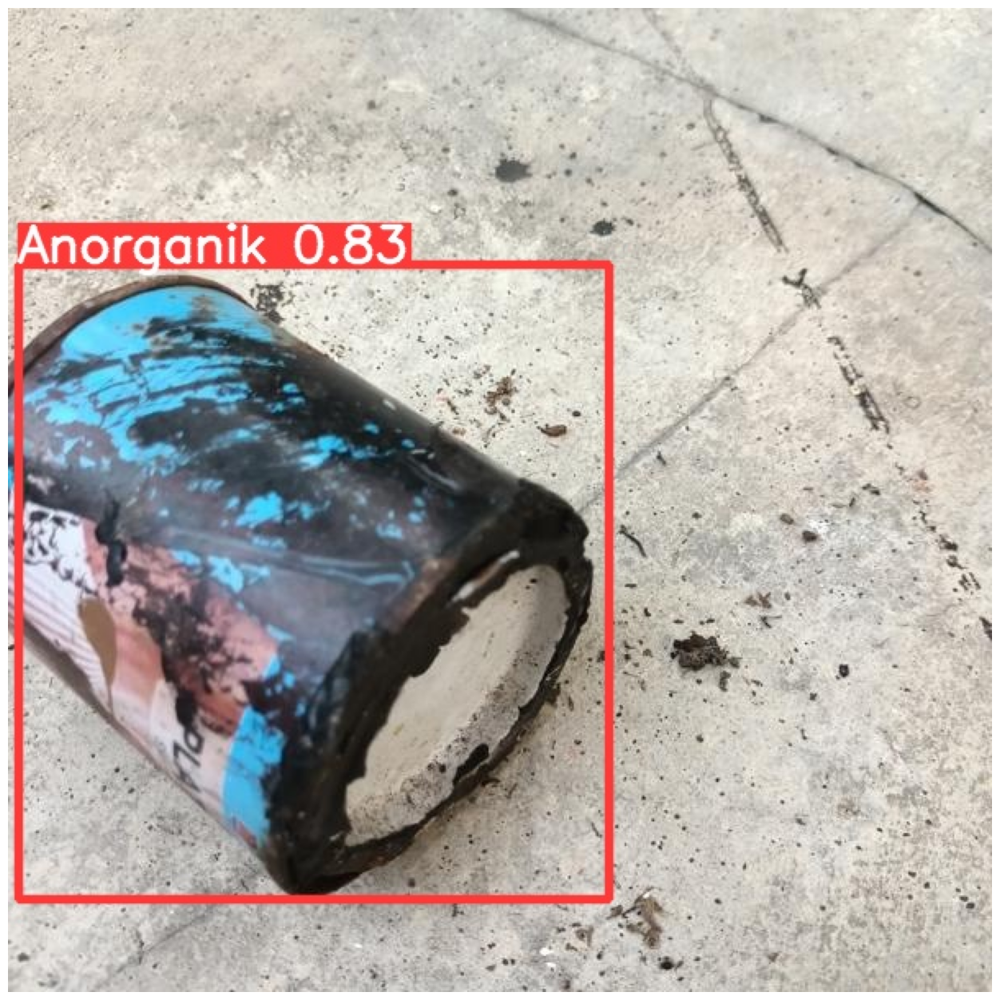

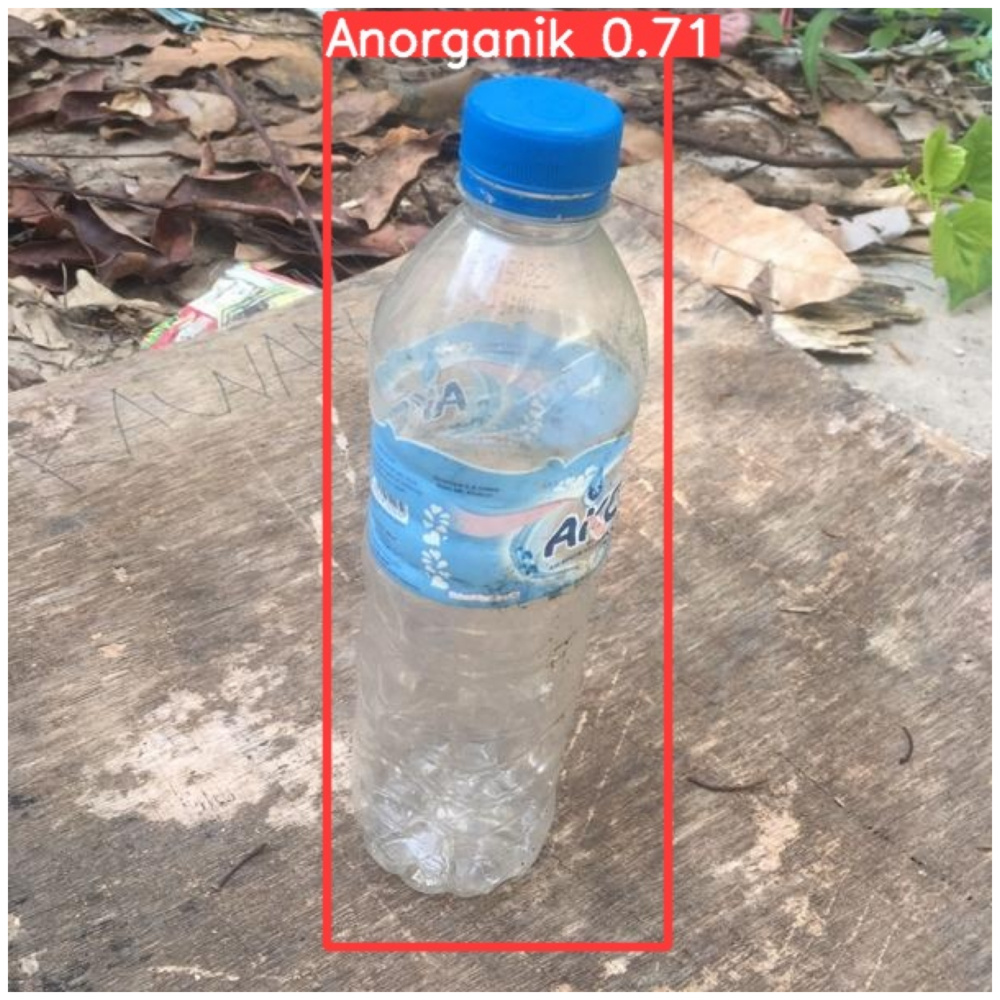

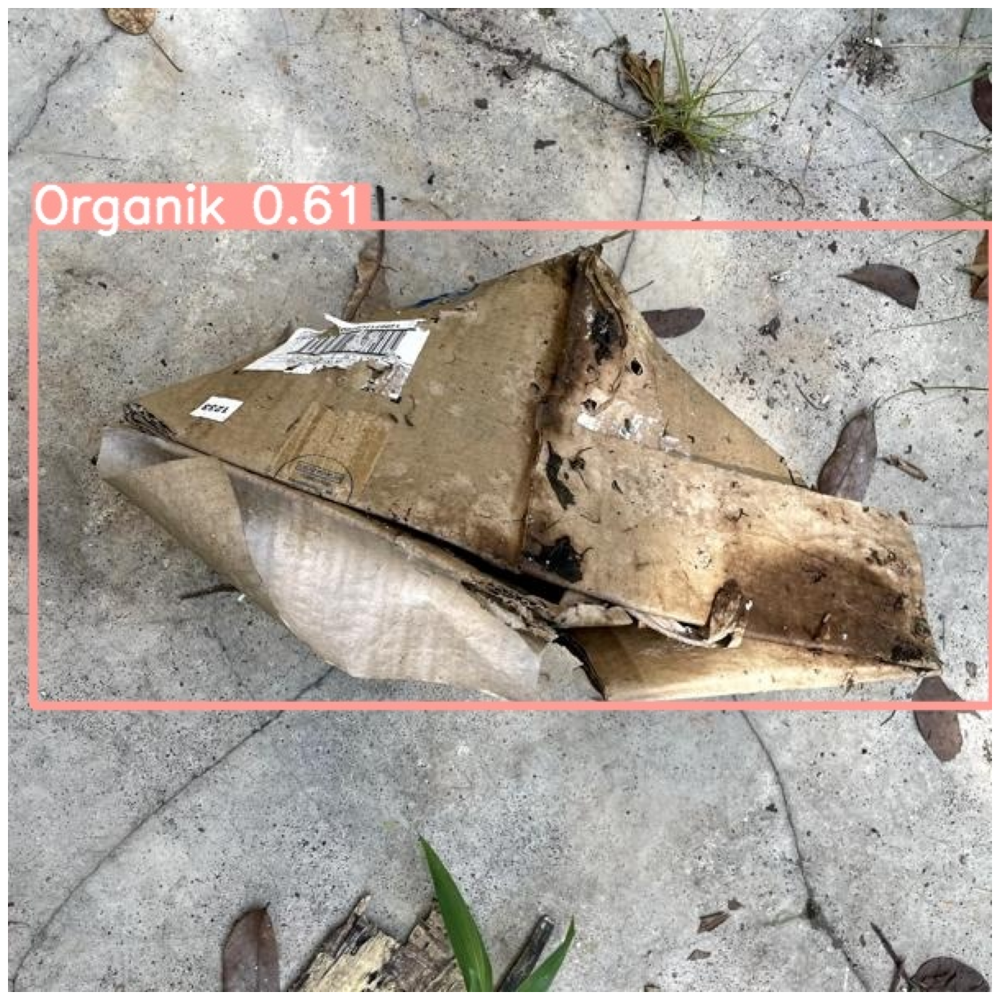

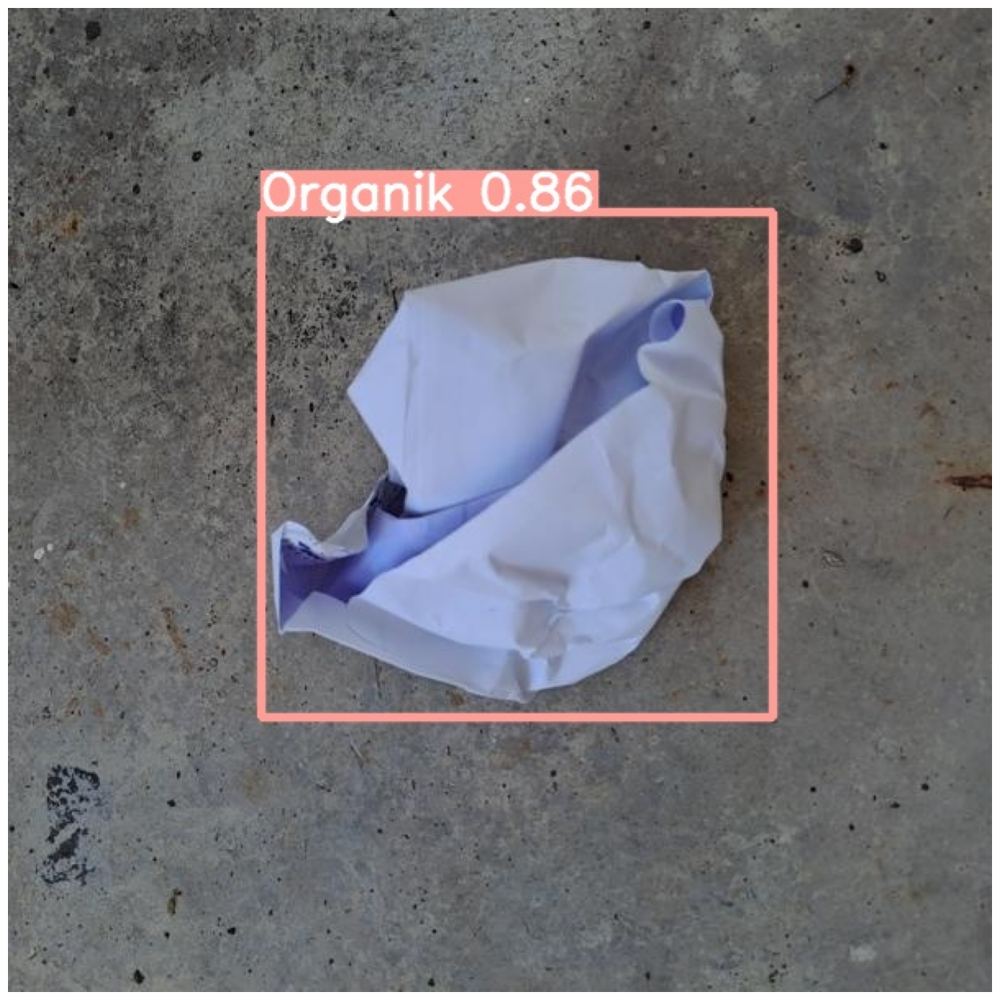

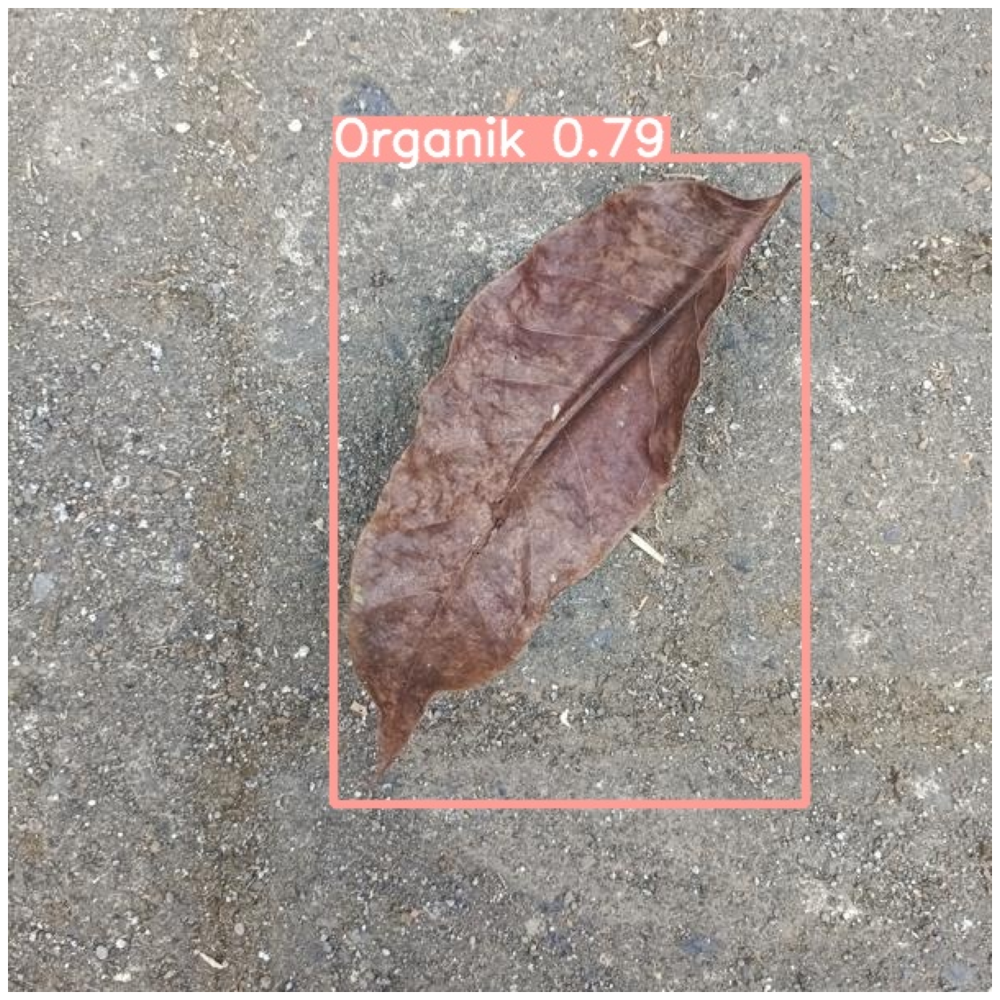

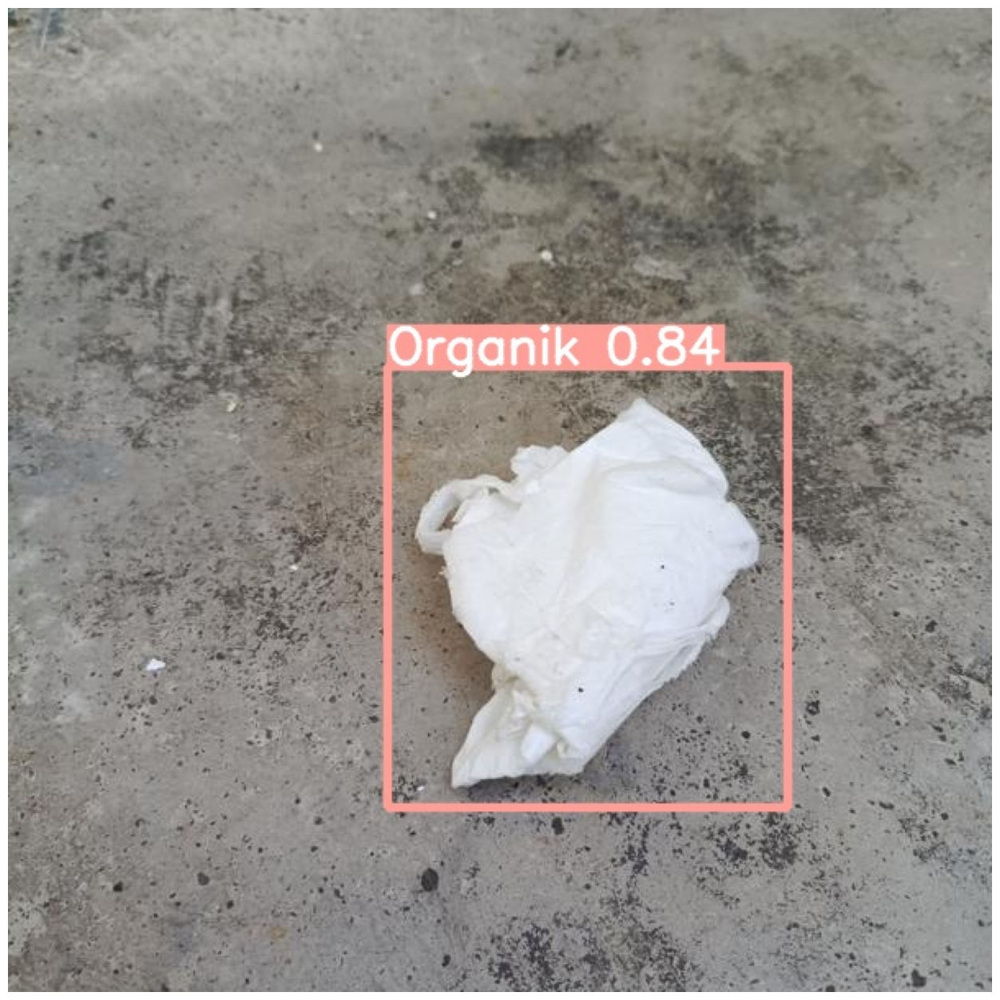

In [ ]:
visualize(IMAGE_INFER_DIR)

# Export Hasil Ke Drive

Koneksi ke google drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Memindahkan hasil training ke google drive

In [ ]:
!cp -r "/content/yolov5" "/content/drive/MyDrive/output"
!cp -r "/content/train" "/content/drive/MyDrive/output"
!cp -r "/content/test" "/content/drive/MyDrive/output"
!cp -r "/content/valid" "/content/drive/MyDrive/output"
!cp -r "/content/data.yaml" "/content/drive/MyDrive/output"